# Preamble

In [1]:
using Plots, DifferentialEquations, QuadGK, MultiQuad, Interpolations, SymPy, LaTeXStrings, SpecialFunctions, Roots;
default(framestyle=:box, guidefont=font(14), titlefont=font(14), tickfont=font(12), legend_font=font(12), legend=false);

In [2]:
Mpl = 2.435e18; # reduced Planck mass in GeV
c = 299792458; # speed of light in m/s
KinGeV = (1.160e4)^-1 * 10^-9; # Kelvin in GeV
Mpcinm = 3.086e16 * 10^6; # Mpc in m
GeVinminv = 10^9/(1.973e-7); # GeV in m^-1
GeVinMpcinv = GeVinminv * Mpcinm; # GeV in Mpc^-1
MpcinvinHz = c/Mpcinm; # Mpc^inv in Hz
yrins = 365.2422 * 24 * 60 * 60; # yr in s

Or0h2 = 4.2e-5; # current radiation density parameter * h^2
Hubblh = 0.674; # normalised Hubble parameter h

In [3]:
Threads.nthreads()

10

# Background

## calculation

In [14]:
ai = [1, 1.11724, 3.12672e-1, -4.68049e-2, -2.65004e-2, -1.19760e-3, 1.82812e-4, 1.36436e-4, 8.55051e-5, 1.22840e-5, 3.82259e-7, -6.87035e-9];
bi = [1.43382e-2, 1.37559e-2, 2.92108e-3, -5.38533e-4, -1.62496e-4, -2.87906e-5, -3.84278e-6, 2.78776e-6, 7.40342e-7, 1.17210e-7, 3.72499e-9, -6.74107e-11];
ci = [1, 6.07869e-1, -1.54485e-1, -2.24034e-1, -2.82147e-2, 2.90620e-2, 6.86778e-3, -1.00005e-3, -1.69104e-4, 1.06301e-5, 1.69528e-6, -9.33311e-8];
di = [7.07388e1, 9.18011e1, 3.31892e1, -1.39779, -1.52558, -1.97857e-2, -1.60146e-1, 8.22615e-5, 2.02651e-2, -1.82134e-5, 7.83943e-5, 7.13518e-5];

In [15]:
Tth = 0.12; # temperature separation in GeV

In [16]:
grhohigh(T) = sum([ai[i]*log(T)^(i - 1) for i=1:12]) / sum([bi[i]*log(T)^(i - 1) for i=1:12]); # eff. DoF for energy density for T > 0.12 GeV
gshigh(T) = grhohigh(T) / (1 + sum([ci[i]*log(T)^(i - 1) for i=1:12]) / sum([di[i]*log(T)^(i - 1) for i=1:12])); # eff. DoF for entropy for T > 0.12 GeV

In [17]:
rhohigh(T) = π^2/30*grhohigh(T)*T^4; # energy density for T > 0.12 GeV
shigh(T) = 2*π^2/45*gshigh(T)*T^3; # entropy for T > 0.12 GeV
phigh(T) = T*shigh(T) - rhohigh(T); # pressure for T > 0.12 GeV

In [18]:
# some fitting functions
Sfit(x) = 1 + 7/4*exp(-1.0419*x) * (1 + 1.034*x + 0.456426*x^2 + 0.0595249*x^3);
frho(x) = exp(-1.04855*x) * (1 + 1.03757*x + 0.508630*x^2 + 0.0893988*x^3);
brho(x) = exp(-1.03149*x) * (1 + 1.03317*x + 0.398264*x^2 + 0.0648056*x^3);
fs(x) = exp(-1.04190*x) * (1 + 1.03400*x + 0.456426*x^2 + 0.0595248*x^3);
bs(x) = exp(-1.03365*x) * (1 + 1.03397*x + 0.342548*x^2 + 0.0506182*x^3);

In [19]:
# mass params. in GeV
me = 511e-6;
mmu = 0.1056;
mpi0 = 0.13;
mpipm = 0.140;
m1 = 0.5;
m2 = 0.77;
m3 = 1.2;
m4 = 2;

In [20]:
Tcut = 1e-2;

In [33]:
# neutrino temperature
function Tnu(T) 
    if T > Tcut
        return (4/11)^(1/3) * Sfit(me/T)^(1/3) * T
    else
        return (4/11)^(1/3) * Sfit(me/Tcut)^(1/3) * T
    end
end;

function Tnudiff(T)
    if T > Tcut
        Tp = symbols("Tp")
        return (4/11)^(1/3) * diff(Sfit(me/Tp)^(1/3) * Tp).subs(Tp,T)
    else
        return (4/11)^(1/3) * Sfit(me/Tcut)^(1/3)
    end
end;

In [35]:
grhogammalowfunc(T) = 2.030 + 3.495*frho(me/T) + 3.446*frho(mmu/T) + 1.05*brho(mpi0/T) + 2.08*brho(mpipm/T) + 4.165*brho(m1/T) + 30.55*brho(m2/T) + 89.4*brho(m3/T) + 8209*brho(m4/T); # eff. DoF for photon energy density for T < 0.12 GeV
gsgammalowfunc(T) = 2.008 + 3.442*fs(me/T) + 3.468*fs(mmu/T) + 1.034*bs(mpi0/T) + 2.068*bs(mpipm/T) + 4.16*bs(m1/T) + 30.55*bs(m2/T) + 90*bs(m3/T) + 6209*bs(m4/T); # eff. DoF for photon entropy for T < 0.12 GeV
grhonulowfunc(T) = 1.353*Sfit(me/T)^(4/3); # eff. DoF for neutrino energy density for T < 0.12 GeV
gsnulowfunc(T) = 1.923*Sfit(me/T); # eff. DoF for neutrino entropy for T < 0.12 GeV

function grhogammalow(T)
    if T > Tcut
        return grhogammalowfunc(T)
    else
        return grhogammalowfunc(Tcut)
    end
end;

function gsgammalow(T)
    if T > Tcut
        return gsgammalowfunc(T)
    else
        return gsgammalowfunc(Tcut)
    end
end;

function grhonulow(T)
    if T > Tcut
        return grhonulowfunc(T)
    else
        return grhonulowfunc(Tcut)
    end
end;

function gsnulow(T)
    if T > Tcut
        return gsnulowfunc(T)
    else
        return gsnulowfunc(Tcut)
    end
end;

function grhogammalowdiff(T)
    if T > Tcut
        Tp = symbols("Tp")
        return diff(grhogammalowfunc(Tp)).subs(Tp,T)
    else
        return 0
    end
end;

function gsgammalowdiff(T)
    if T > Tcut
        Tp = symbols("Tp")
        return diff(gsgammalowfunc(Tp)).subs(Tp,T)
    else
        return 0
    end
end;

function grhonulowdiff(T)
    if T > Tcut
        Tp = symbols("Tp")
        return diff(grhonulowfunc(Tp)).subs(Tp,T)
    else
        return 0
    end
end;

function gsnulowdiff(T)
    if T > Tcut
        Tp = symbols("Tp")
        return diff(gsnulowfunc(Tp)).subs(Tp,T)
    else
        return 0
    end
end;

In [43]:
# T < 0.12 GeV
rhogammalow(T) = π^2/30*grhogammalow(T)*T^4; # photon energy density
sgammalow(T) = 2*π^2/45*gsgammalow(T)*T^3; # photon entropy
rhonulow(T) = π^2/30*grhonulow(T)*T^4; # neutrino energy density
snulow(T) = 2*π^2/45*gsnulow(T)*T^3; # neutrino entropy
pgammalow(T) = T*sgammalow(T) - rhogammalow(T); # photon pressure
pnulow(T) = Tnu(T)*snulow(T) - rhonulow(T); # neutrino pressure
rholow(T) = rhogammalow(T) + rhonulow(T); # total energy density
plow(T) = pgammalow(T) + pnulow(T); # total pressure

rhogammalowdiff(T) = π^2/30*(grhogammalowdiff(T)*T^4+4*grhogammalow(T)*T^3);
sgammalowdiff(T) = 2*π^2/45*(gsgammalowdiff(T)*T^3+3*gsgammalow(T)*T^2);
rhonulowdiff(T) = π^2/30*(grhonulowdiff(T)*T^4+4*grhonulow(T)*T^3);
snulowdiff(T) = 2*π^2/45*(gsnulowdiff(T)*T^3+3*gsnulow(T)*T^2);
pgammalowdiff(T) = sgammalow(T) + T*sgammalowdiff(T) - rhogammalowdiff(T);
pnulowdiff(T) = Tnudiff(T)*snulow(T) + Tnu(T)*snulowdiff(T) - rhonulowdiff(T);
rholowdiff(T) = rhogammalowdiff(T) + rhonulowdiff(T);
plowdiff(T) = pgammalowdiff(T) + pnulowdiff(T);

In [44]:
function grho(T) # eff. DoF for energy density
    if T >= Tth
        return grhohigh(T)
    elseif T > Tcut
        return grhogammalow(T) + grhonulow(T)
    else
        return grhogammalow(Tcut) + grhonulow(Tcut)
    end
end;

function grhop(T) # T-derivative of grho
    Tp = symbols("Tp")
    if T >= Tth
        return diff(grhohigh(Tp)).subs(Tp,T)
    else 
        return grhogammalowdiff(T) + grhonulowdiff(T) 
    end
end;

function gs(T) # eff. DoF for entropy
    if T >= Tth
        return gshigh(T)
    elseif T > Tcut
        return gsgammalow(T) + gsnulow(T)
    else
        return gsgammalow(Tcut) + gsnulow(Tcut)
    end
end;

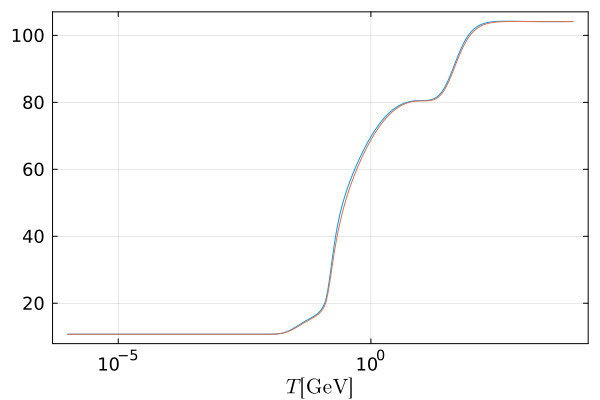

In [45]:
Tlist = [10^i for i=-6:0.01:4]
plot(grho, Tlist, xscale=:log10, label=L"$g_*$", xlabel=L"$T\,[\mathrm{GeV}]$")
plot!(gs, Tlist, label=L"$g_{*s}$")

In [46]:
function rho(T) # energy density
    if T >= Tth
        return rhohigh(T)
    else 
        return rholow(T)
    end
end;

function press(T) # pressure
    if T >= Tth
        return phigh(T)
    else
        return plow(T)
    end
end;

In [47]:
EoSw(T) = press(T)/rho(T); # equation-of-state param. w

function cs2(T) # sound speed squared
    Tp = symbols("Tp")
    if T >= Tth
        return (diff(phigh(Tp))/diff(rhohigh(Tp))).subs(Tp,T)
    else
        return plowdiff(T)/rholowdiff(T)
    end
end;

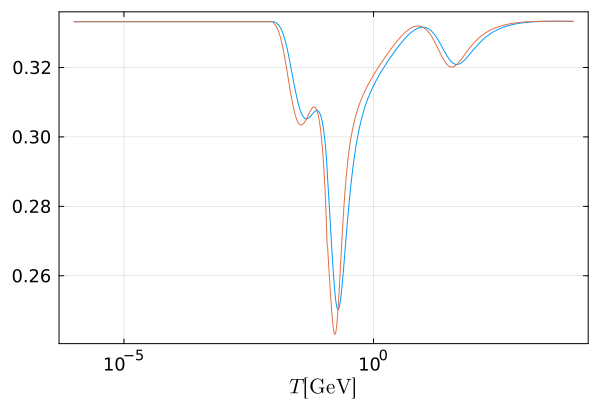

In [48]:
plot(EoSw, Tlist, xscale=:log10, label=L"$w$", xlabel=L"$T\,[\mathrm{GeV}]$")
plot!(cs2, Tlist, label=L"$c_\mathrm{s}^2$")

In [49]:
T0 = 2.725*KinGeV; # current temperature
grho0 = grho(T0); # current grho
gs0 = gs(T0); # current gs

In [50]:
calH(T, scalea) = scalea * sqrt(rho(T)/3/Mpl^2) * GeVinMpcinv; # conformal Hubble in Mpc^-1

In [51]:
Ti = 1e6; # initial temperature
scaleai = (gs0/gs(Ti))^(1/3)*T0/Ti; # temporal initial scale factor 
etai = 1/calH(Ti, scaleai); # initial conformal time

etaf = 10; # final conformal time

In [52]:
etai

4.178746239676742e-14

In [53]:
function bgEoM(du,u,p,lneta) # u[1] = T, u[2] = scalea
    du[1] = -3*exp(lneta)*(1 + EoSw(u[1])) * calH(u[1], u[2]) * grho(u[1]) / (grhop(u[1]) + 4*grho(u[1])/u[1])
    du[2] = exp(lneta)*u[2]*calH(u[1],u[2])
end;

ui = [Ti,scaleai];
lnetaspan = (log(etai),log(etaf));
bgprob = ODEProblem(bgEoM,ui,lnetaspan);
@time bgsol = solve(bgprob,Tsit5(),reltol=1e-10,abstol=1e-10);

 45.221980 seconds (12.31 M allocations: 410.839 MiB, 0.54% gc time, 0.81% compilation time)


In [54]:
Tsol(eta) = bgsol(log(eta))[1];
asol(eta) = bgsol(log(eta))[2];

In [55]:
norm = Tsol(etaf)/T0*asol(etaf); # renormalisation factor so that a0 = 1
anorm(eta) = asol(eta/norm)/norm; # renormalised scale factor
Tnorm(eta) = Tsol(eta/norm); # T with the renormalised eta
calHnorm(eta) = calH(Tnorm(eta), anorm(eta)); # calH with the renormalised eta
rhoQnorm(eta) = rho(Tnorm(eta))^(1/4)
af = anorm(norm*etaf); # renormalised scale factor at the final time
calHf = calHnorm(norm*etaf); # calH at the final time

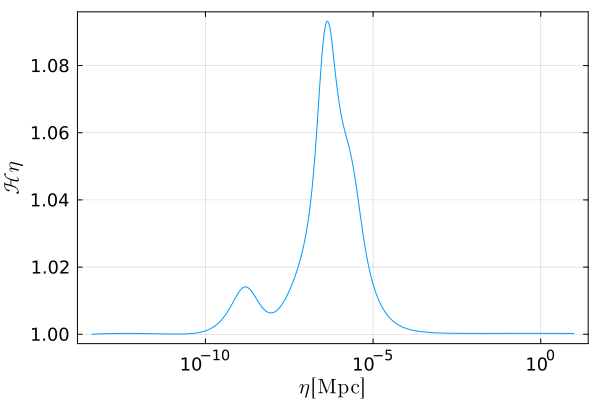

In [56]:
etalist = [10^i for i=log10(norm*etai):0.01:log10(norm*etaf)];
plot(etalist, map(x -> x*calHnorm(x), etalist), xscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$\mathcal{H}\eta$", legend=false)

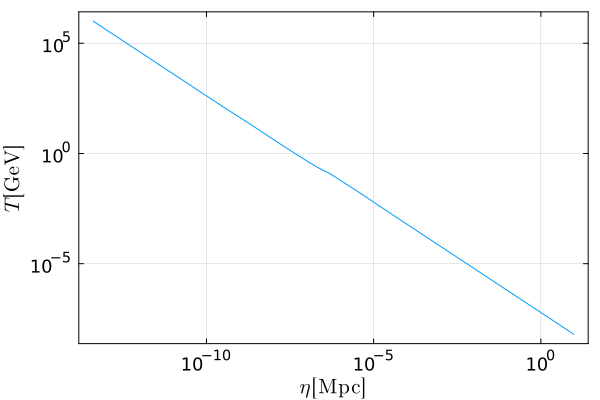

In [57]:
plot(Tnorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$T\,[\mathrm{GeV}]$", legend=false)

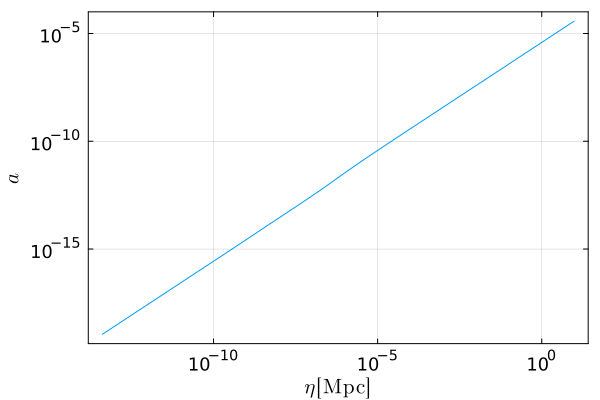

In [58]:
plot(anorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$a$", legend=false)

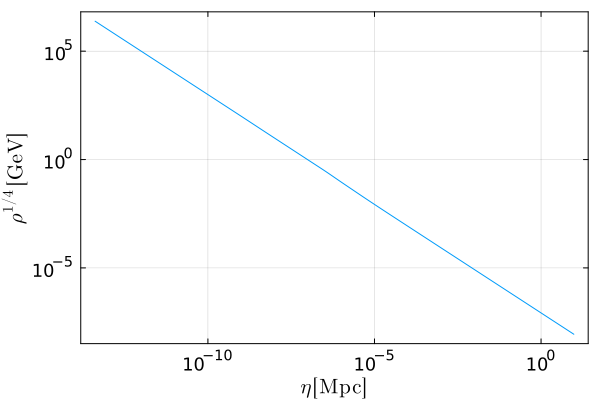

In [59]:
plot(rhoQnorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$\rho^{1/4}\,[\mathrm{GeV}]$")

In [60]:
rhoQis1e4(eta) = rhoQnorm(eta) - 1e4;
eta1e4 = find_zero(rhoQis1e4, (etai*norm,1e-10))

9.949911267998388e-12

In [61]:
rhoQnorm(eta1e4)

9999.999999999998

In [62]:
anorm(eta1e4)

2.7101917485646706e-17

In [63]:
EoSwsol(eta) = EoSw(Tnorm(eta));
cs2sol(eta) = cs2(Tnorm(eta));
grhosol(eta) = grho(Tnorm(eta));
gssol(eta) = gs(Tnorm(eta));

In [65]:
lnetaspan = log10(norm*etai):0.01:log10(norm*etaf)

lnetaList = [lneta for lneta in lnetaspan];
anormList = [anorm(10^lneta) for lneta in lnetaspan];
calHList = [calHnorm(10^lneta) for lneta in lnetaspan];
EoSwList = [EoSwsol(10^lneta) for lneta in lnetaspan];
cs2List = [cs2sol(10^lneta) for lneta in lnetaspan];
grhoList = [grhosol(10^lneta) for lneta in lnetaspan];
gsList = [gssol(10^lneta) for lneta in lnetaspan];

In [66]:
open("data/noep/bg.dat","w") do out
    Base.print_array(out, hcat(lnetaList[:],anormList[:],calHList[:],EoSwList[:],cs2List[:],grhoList[:],gsList[:]))
end

## load

In [4]:
f = open("data/noep/bg.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnetaList = [numarray[i][1] for i=1:length(numarray)];
anormList = [numarray[i][2] for i=1:length(numarray)];
calHList = [numarray[i][3] for i=1:length(numarray)];
EoSwList = [numarray[i][4] for i=1:length(numarray)];
cs2List = [numarray[i][5] for i=1:length(numarray)];
grhoList = [numarray[i][6] for i=1:length(numarray)];
gsList = [numarray[i][7] for i=1:length(numarray)];

In [5]:
lnetaspan = range(lnetaList[1], lnetaList[length(lnetaList)], length=length(lnetaList))
etai = 10^lnetaList[1];
etaf = 10^lnetaList[length(lnetaList)];

aCSI = CubicSplineInterpolation(lnetaspan, anormList);
aint(eta) = aCSI(log10(eta));

calHCSI = CubicSplineInterpolation(lnetaspan, calHList);
function calHint(eta) 
    if eta < etai
        return 1/eta
    else
        return calHCSI(log10(eta))
    end
end;

EoSwCSI = CubicSplineInterpolation(lnetaspan, EoSwList);
function EoSwint(eta) 
    if eta < etai
        return 1/3
    else
        return EoSwCSI(log10(eta))
    end
end;

cs2CSI = CubicSplineInterpolation(lnetaspan, cs2List);
function cs2int(eta) 
    if eta < etai
        return 1/3
    else
        return cs2CSI(log10(eta))
    end
end;

grhoCSI = CubicSplineInterpolation(lnetaspan, grhoList);
grhoint(eta) = grhoCSI(log10(eta));

gsCSI = CubicSplineInterpolation(lnetaspan, gsList);
gsint(eta) = gsCSI(log10(eta));

In [6]:
(etai, etaf)

(4.110700539299489e-14, 9.636422655377029)

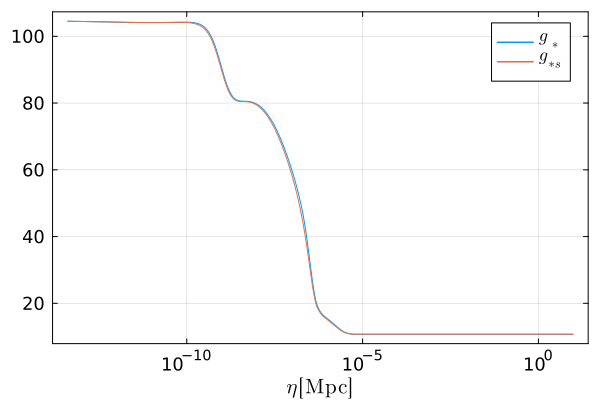

In [7]:
etaList = [10^lnetaList[i] for i=1:length(lnetaList)];
plot(grhoint, etaList, xscale=:log10, label=L"$g_*$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(gsint, etaList, label=L"$g_{*s}$")

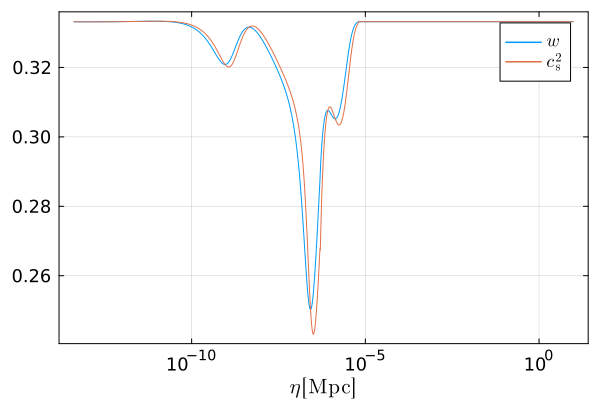

In [8]:
plot(EoSwint, etaList, xscale=:log10, label=L"$w$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(cs2int, etaList, label=L"$c_\mathrm{s}^2$")

In [9]:
(aint(400/1e5)*calHint(400/1e5)/aint(etaf)/calHint(etaf))^2

0.9959219909382964

In [10]:
etaf/aint(etaf)

259975.2132699237

In [11]:
2.4e4/0.07

342857.14285714284

# Scalar

## calculation

In [18]:
kmin = 1e3;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 0.01;
xf = 400;
xList = [x for x=xi:0.01:xf];

In [19]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = 3*(9*x*cos(x/sqrt(3)) + sqrt(3)*(x^2-9)*sin(x/sqrt(3)))/x^4;

In [20]:
function scalarEoM(du,u,p,x) # u[1] = Phi, u[2] = dPhidx, p[1] = k
    eta = x/p[1]
    du[1] = u[2]
    du[2] = - 3*calHint(eta)/p[1]*(1 + cs2int(eta))*u[2] - (cs2int(eta) + 3*calHint(eta)^2/p[1]^2*(cs2int(eta) - EoSwint(eta)))*u[1]
end;

ui = [PhiRD(xi),PhipRD(xi)];
xspan = (xi,xf);

function scalarList()
    scalarList = [[] for i=1:length(kList)]
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        scalarprob = ODEProblem(scalarEoM,ui,xspan,p)
        scalarsol = solve(scalarprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        Phisol(x) = scalarsol(x)[1]
        Pisol(x) = scalarsol(x)[2]
        scalarList[i] = [p[1],Phisol,Pisol]
    end
    return scalarList
end;

In [21]:
@time scalarsol = scalarList();

  1.608864 seconds (204.22 M allocations: 3.681 GiB, 24.55% gc time, 260.39% compilation time)


In [22]:
length(scalarsol)

601

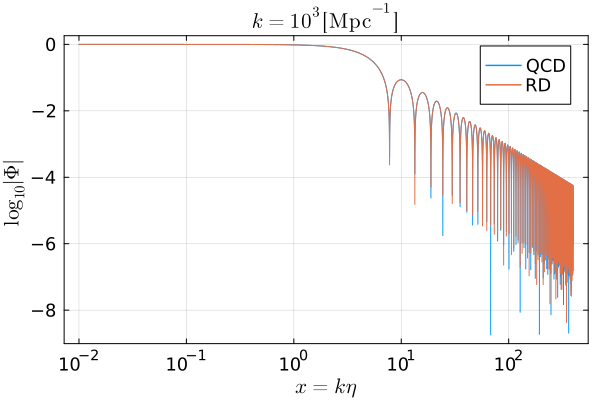

In [24]:
plot(xList, [log10(abs(scalarsol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", title=L"$k = 10^3\, [\mathrm{Mpc}^{-1}]$", 
    label="QCD", legend=true)
plot!(xList, [log10(abs(PhiRD(xList[i]))) for i=1:length(xList)], label="RD")

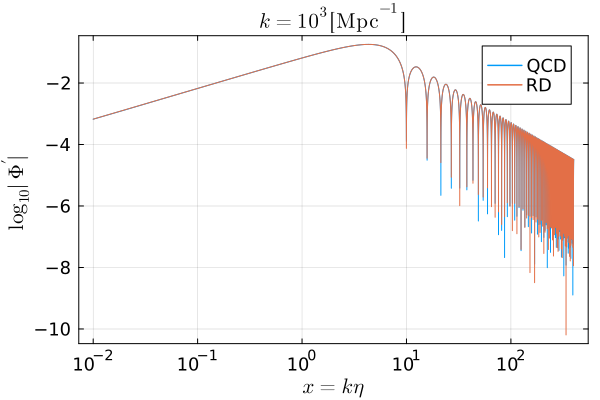

In [25]:
plot(xList, [log10(abs(scalarsol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime|$", title=L"$k = 10^3\, [\mathrm{Mpc}^{-1}]$", 
    label="QCD", legend=true)
plot!(xList, [log10(abs(PhipRD(big(xList[i])))) for i=1:length(xList)], label = "RD")

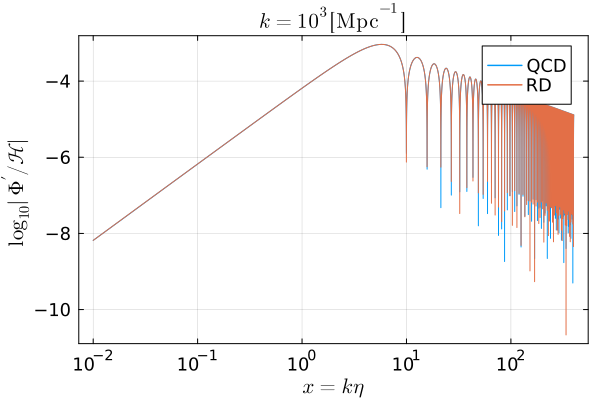

In [26]:
plot(xList, [log10(abs(scalarsol[1][3](xList[i]) / calHint(xList[i]/kList[1]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime/\mathcal{H}|$", 
    title=L"$k = 10^3\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(xList, [log10(abs(PhipRD(big(xList[i])) / calHint(xList[i]/kList[1]))) for i=1:length(xList)], label = "RD")

In [27]:
@time begin
    open("data/noep/Phi.dat","w") do out
        Base.print_array(out, [scalarsol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end;

    open("data/noep/Pi.dat","w") do out
        Base.print_array(out, [scalarsol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end
end;

128.952490 seconds (2.43 G allocations: 131.920 GiB, 8.12% gc time, 0.66% compilation time)


## load

In [28]:
@time begin
    f = open("data/noep/Phi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PhiList = reduce(hcat,numarray);

    f = open("data/noep/Pi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PiList = reduce(hcat,numarray);
end;

  9.679651 seconds (1.47 M allocations: 4.094 GiB, 4.96% gc time, 0.80% compilation time)


In [29]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = 3*(9*x*cos(x/sqrt(3)) + sqrt(3)*(x^2-9)*sin(x/sqrt(3)))/x^4;
PhiRDf(x,Phif,Pif) = ((9*Phif*xf + 3*Pif*xf*(-x + xf) + Phif*x*(-9 + xf^2))*cos((x - xf)/sqrt(3)) 
    + sqrt(3)*(Pif*xf*(3 + x*xf) + Phif*(9 + 3*x*xf - xf^2))*sin((x - xf)/sqrt(3))) / x^3;
PhipRDf(x,Phif,Pif) = (3*(Pif*xf*(9*x - 9*xf + x^2*xf) 
        + 3*Phif*(-9*xf + x^2*xf - x*(-9 + xf^2)))*cos((x - xf)/sqrt(3)) 
    - sqrt(3)*(3*Pif*xf*(9 - x^2 + 3*x*xf) 
        + Phif*(27*x*xf - 9*(-9 + xf^2) + x^2*(-9 + xf^2)))*sin((x - xf)/sqrt(3))) / 3/x^4;

In [30]:
kmin = 1e3;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

PhiCSI = CubicSplineInterpolation((lnkspan, xspan), PhiList);
function Phiint(k,x)
    if x < xi
        return PhiRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf)) 
    else
        return PhiCSI(log10(k),x)
    end;
end;

PiCSI = CubicSplineInterpolation((lnkspan, xspan), PiList);
function Piint(k,x) 
    if x < xi
        return PhipRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else
        return PiCSI(log10(k),x)
    end
end;

In [31]:
lnxplotList = [10^lnx for lnx=-5:0.01:2];
xplotList = [x for x=0.01:0.01:500];

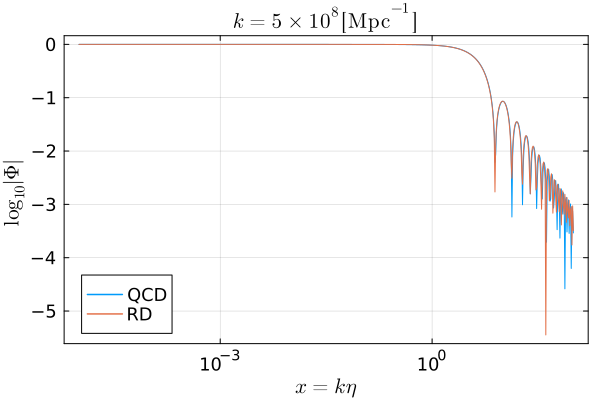

In [32]:
plot(lnxplotList, [log10(abs(Phiint(5e8,lnxplotList[i]))) for i=1:length(lnxplotList)], 
    xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=:bottomleft, label="QCD")
plot!(lnxplotList, [log10(abs(PhiRD(lnxplotList[i]))) for i=1:length(lnxplotList)], label="RD")

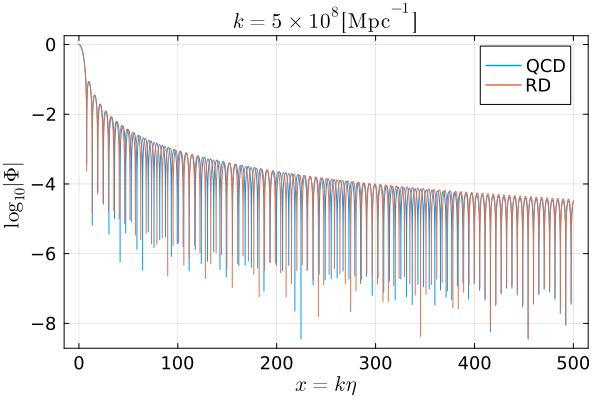

In [33]:
plot(xplotList, [log10(abs(Phiint(5e8,xplotList[i]))) for i=1:length(xplotList)], 
    xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xplotList, [log10(abs(PhiRD(xplotList[i]))) for i=1:length(xplotList)], label="RD")

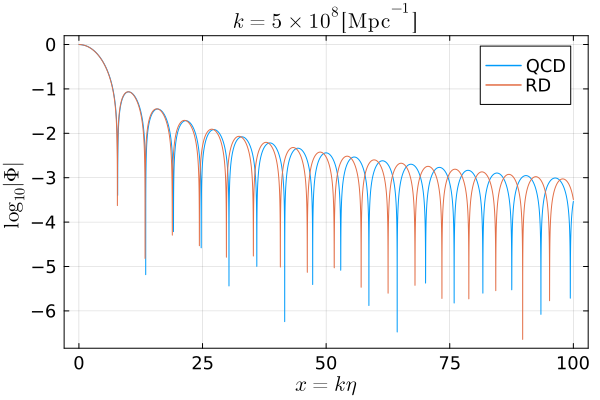

In [34]:
xzoom  = [x for x=0.01:0.01:100];

plot(xzoom, [log10(abs(Phiint(5e8,xzoom[i]))) for i=1:length(xzoom)], 
    xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xzoom, [log10(abs(PhiRD(xzoom[i]))) for i=1:length(xzoom)], label="RD")

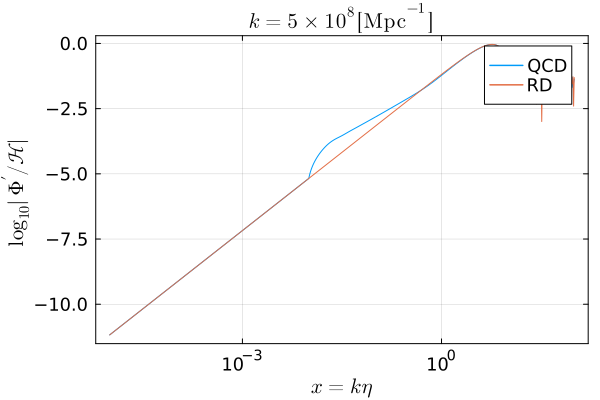

In [35]:
plot(lnxplotList, [log10(abs(Piint(5e8,big(lnxplotList[i]))*5e8 / calHint(lnxplotList[i]/5e8))) 
        for i=1:length(lnxplotList)], xscale=:log10, xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(lnxplotList, [log10(abs(PhipRD(big(lnxplotList[i])) *lnxplotList[i])) 
        for i=1:length(lnxplotList)], label="RD")

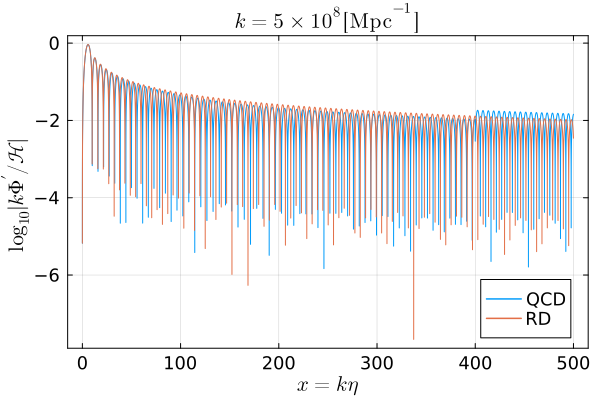

In [36]:
plot(xplotList, [log10(abs(Piint(5e8,big(xplotList[i])) *5e8 / calHint(xplotList[i]/5e8))) 
        for i=1:length(xplotList)], xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|k\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xplotList, [log10(abs(PhipRD(big(xplotList[i])) *xplotList[i])) 
        for i=1:length(xplotList)], label="RD")

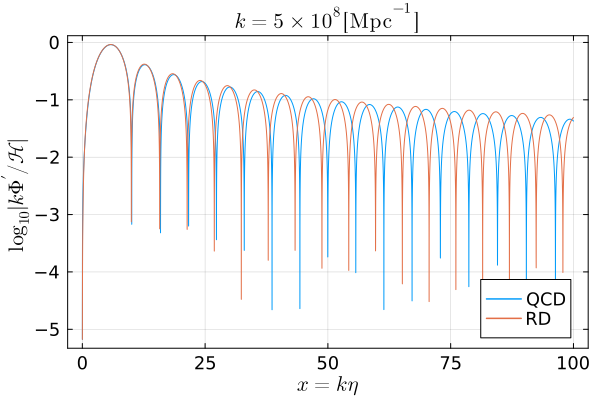

In [37]:
plot(xzoom, [log10(abs(Piint(5e8,big(xzoom[i])) *5e8 / calHint(xzoom[i]/5e8))) 
        for i=1:length(xzoom)], xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|k\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xzoom, [log10(abs(PhipRD(big(xzoom[i])) *xzoom[i])) 
        for i=1:length(xzoom)], label="RD")

In [38]:
aRD(eta) = eta/etaf*aint(etaf);

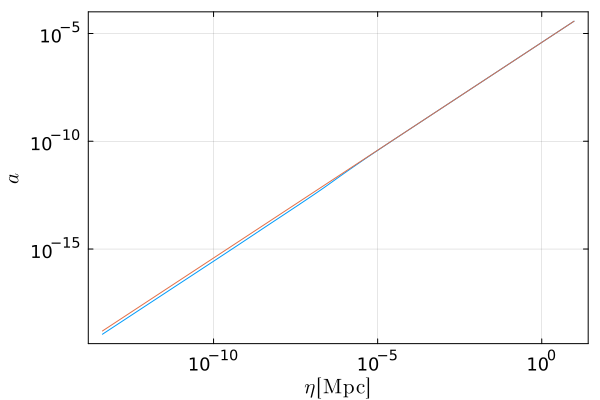

In [39]:
etalist = [10^lneta for lneta=log10(etai):0.01:log10(etaf)];

plot(aint, etalist, xscale=:log10, yscale=:log10, 
    xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$a$")
plot!(aRD, etalist)

In [40]:
ks = 1e8;
lnxzoom = [10^lnx for lnx=-2:0.01:2];

sourceQCD1e8(x) = aint(x/ks)* (2*Phiint(ks,x)*Phiint(ks,x) 
    + 4/3/(1+EoSwint(x/ks))*(Phiint(ks,x)+Piint(ks,x)*ks/calHint(x/ks))^2);

sourceRD1e8(x) = aRD(x/ks)* (2*PhiRD(x)*PhiRD(x) + (PhiRD(x)+PhipRD(x)*x)^2);

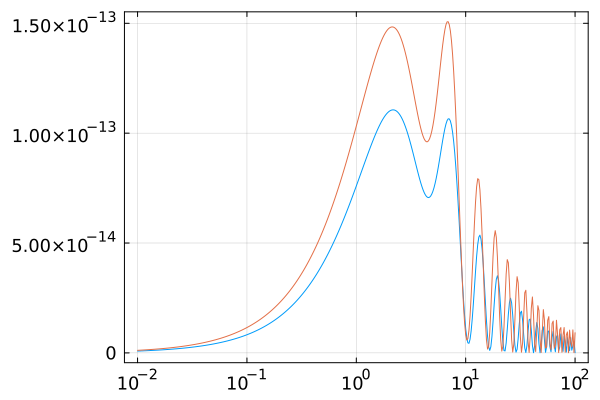

In [41]:
plot(lnxzoom, [sourceQCD1e8(lnxzoom[i]) for i=1:length(lnxzoom)], xscale=:log10)
plot!(lnxzoom, [sourceRD1e8(lnxzoom[i]) for i=1:length(lnxzoom)])

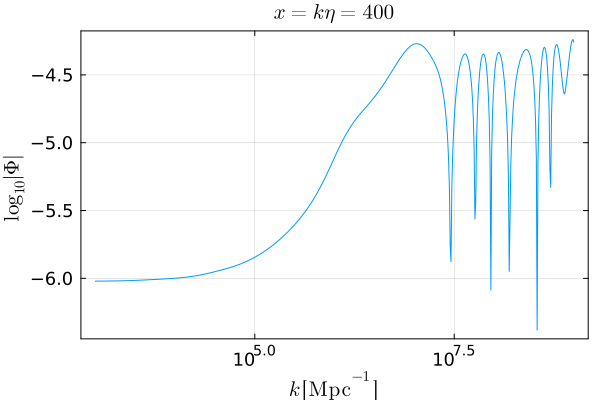

In [42]:
plot(kList, [log10(abs(Phiint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|\Phi|$", title=L"$x = k\eta = 400$")

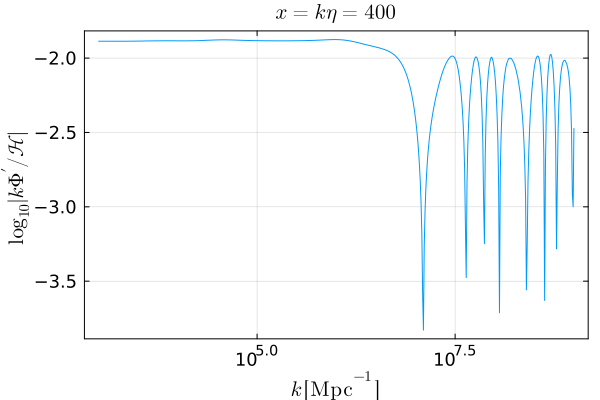

In [43]:
plot(kList, [log10(abs(Piint(kList[i],xf)*kList[i] / calHint(xf/kList[i]))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k \,[\mathrm{Mpc}^{-1}]$", 
    ylabel=L"$\log_{10}|k\Phi^\prime / \mathcal{H}|$", 
    title=L"$x = k\eta = 400$")

# Tensor

## calculation

In [44]:
kmin = 1e3;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

In [45]:
function gkEoM(du,u,p,x) # u[1] = g, u[2] = dgdx, p[1] = k
    du[1] = u[2]
    du[2] = - (1 - (1-3*EoSwint(x/p[1]))/2*calHint(x/p[1])^2/p[1]^2)*u[1]
end;

xspan = (xi, xf);

function gkList(ui)
    gkList = [[] for i=1:length(kList)]
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        tensorprob = ODEProblem(gkEoM,ui,xspan,p)
        tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        gsol(x) = tensorsol(x)[1]
        gpsol(x) = tensorsol(x)[2]
        gkList[i] = [p[1],gsol,gpsol]
    end
    return gkList
end;

In [46]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [47]:
ui1 = [g1RD(xi),g1pRD(xi)];
ui2 = [g2RD(xi),g2pRD(xi)];

@time g1sol = gkList(ui1);
@time g2sol = gkList(ui2);

 14.805584 seconds (776.81 M allocations: 15.915 GiB, 73.47% gc time, 9.67% compilation time)
 23.309370 seconds (714.26 M allocations: 14.554 GiB, 85.99% gc time)


In [48]:
length(g1sol)

601

In [49]:
length(g2sol)

601

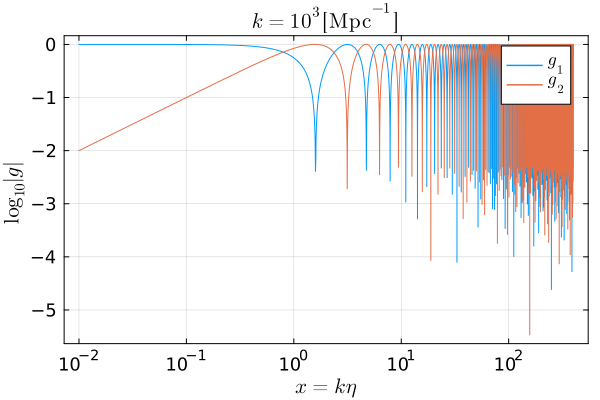

In [50]:
plot(xList, [log10(abs(g1sol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^3\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xList, [log10(abs(g2sol[1][2](xList[i]))) for i=1:length(xList)], label=L"$g_2$")

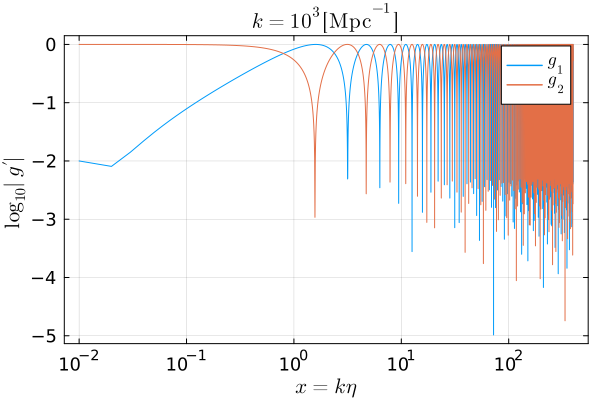

In [51]:
plot(xList, [log10(abs(g1sol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^3\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xList, [log10(abs(g2sol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

In [52]:
@time begin  
    open("data/noep/g1.dat","w") do out
        Base.print_array(out, [g1sol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end

    open("data/noep/g1p.dat","w") do out
        Base.print_array(out, [g1sol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end

    open("data/noep/g2.dat","w") do out
        Base.print_array(out, [g2sol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end

    open("data/noep/g2p.dat","w") do out
        Base.print_array(out, [g2sol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end
end;

405.846695 seconds (4.89 G allocations: 264.152 GiB, 45.66% gc time, 0.03% compilation time)


In [53]:
hkRD(x) = sin(x)/x;
hpRD(x) = cos(x)/x - sin(x)/x^2;

In [54]:
function hkEoM(du,u,p,x) # u[1] = h, u[2] = dhdx, p[1] = k
    du[1] = u[2]
    du[2] = -2*calHint(x/p[1])/p[1]*u[2] - u[1]
end;

xspan = (xi, xf);
ui = [hkRD(xi),hpRD(xi)];

function hkList()
    hkList = [[] for i=1:length(kList)]
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        tensorprob = ODEProblem(hkEoM,ui,xspan,p)
        tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        hsol(x) = tensorsol(x)[1]
        hpsol(x) = tensorsol(x)[2]
        hkList[i] = [p[1],hsol,hpsol]
    end
    return hkList
end;

In [55]:
@time hksol = hkList();

  7.660231 seconds (173.56 M allocations: 4.250 GiB, 85.47% gc time, 21.70% compilation time)


In [56]:
length(hksol)

601

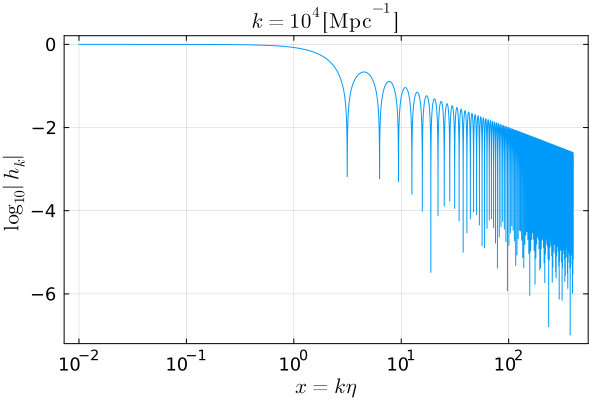

In [57]:
plot(xList, [log10(abs(hksol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

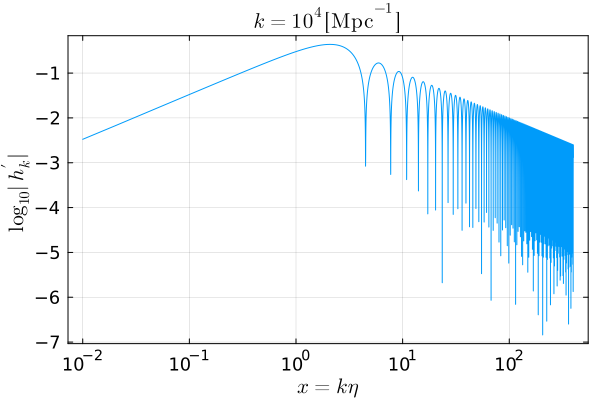

In [58]:
plot(xList, [log10(abs(hksol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [ ]:
@time begin
    open("data/noep/hk.dat","w") do out
        Base.print_array(out, [hksol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end

    open("data/noep/hkp.dat","w") do out
        Base.print_array(out, [hksol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
    end
end;

In [117]:
@time begin
    f = open("data/noep/g1.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1List = reduce(hcat,numarray);


    f = open("data/noep/g1p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1pList = reduce(hcat,numarray);


    f = open("data/noep/g2.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2List = reduce(hcat,numarray);


    f = open("data/noep/g2p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2pList = reduce(hcat,numarray);
end;

 73.619107 seconds (2.86 M allocations: 7.248 GiB, 79.87% gc time, 0.17% compilation time)


In [118]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

g1CSI = CubicSplineInterpolation((lnkspan, xspan), g1List);
g1int(k,x) = g1CSI(log10(k),x);

g1pCSI = CubicSplineInterpolation((lnkspan, xspan), g1pList);
g1pint(k,x) = g1pCSI(log10(k),x);

g2CSI = CubicSplineInterpolation((lnkspan, xspan), g2List);
g2int(k,x) = g2CSI(log10(k),x);

g2pCSI = CubicSplineInterpolation((lnkspan, xspan), g2pList);
g2pint(k,x) = g2pCSI(log10(k),x);

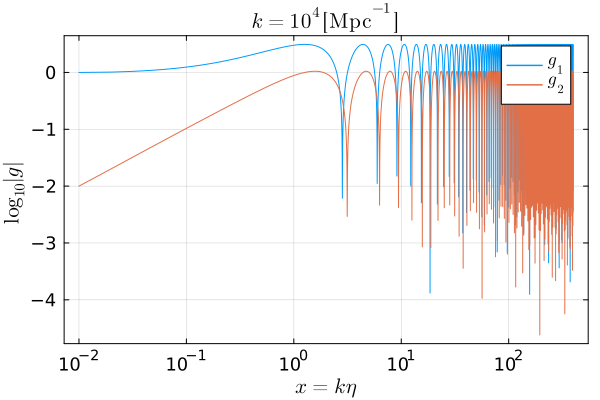

In [42]:
plot(xList, [log10(abs(g1int(1e4,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g2int(1e4,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

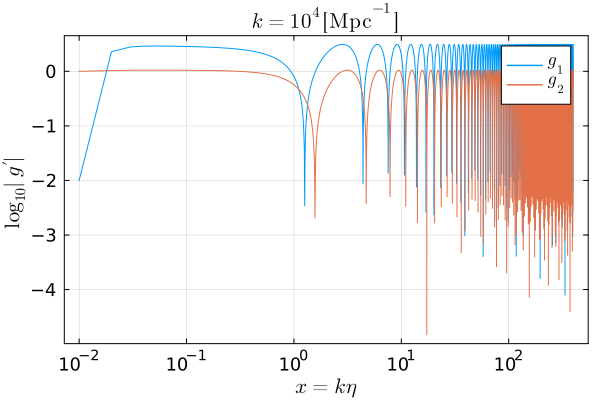

In [43]:
plot(xList, [log10(abs(g1pint(1e4,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g2pint(1e4,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

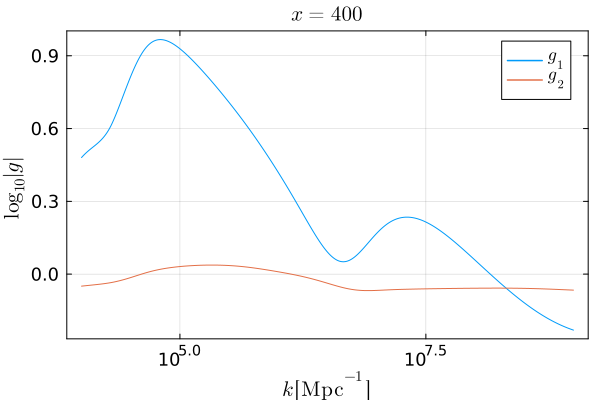

In [44]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

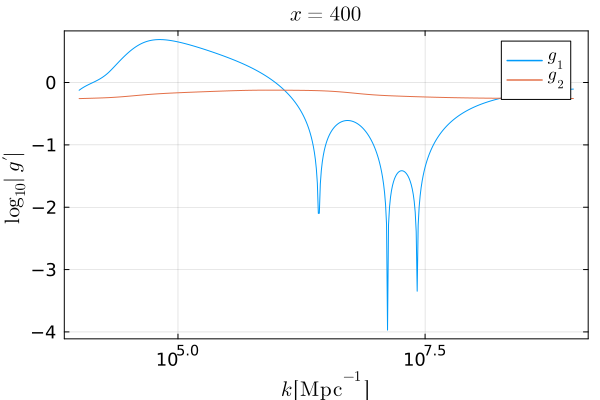

In [45]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

In [46]:
normNk(k,x) = g1pint(k,x)g2int(k,x)-g2pint(k,x)g1int(k,x);

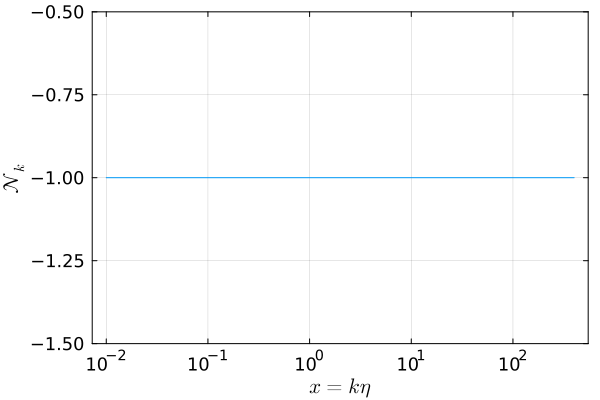

In [47]:
plot(xList, [normNk(1e5,xList[i]) for i=1:length(xList)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$x = k\eta$", ylabel=L"$\mathcal{N}_k$")

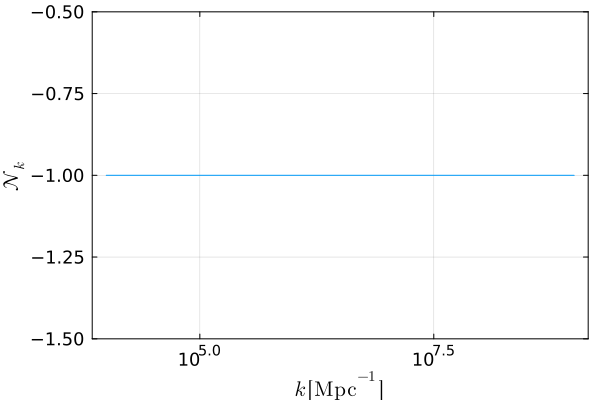

In [48]:
plot(kList, [normNk(kList[i],xi) for i=1:length(kList)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\mathcal{N}_k$")

In [49]:
dx = 2*2*π;

function g1g1bar(k)
    f(x) = g1int(k,x)*g1int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g2g2bar(k)
    f(x) = g2int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g1g2bar(k)
    f(x) = g1int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

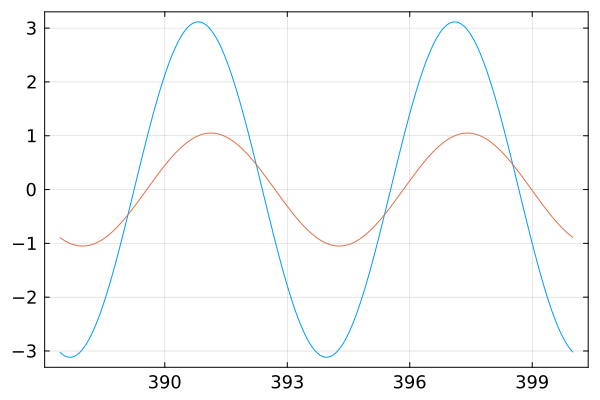

In [51]:
lastxList = [x for x=xf-dx:0.01:xf];

plot(lastxList, [g1int(1e4,lastxList[i]) for i=1:length(lastxList)])
plot!(lastxList, [g2int(1e4,lastxList[i]) for i=1:length(lastxList)])

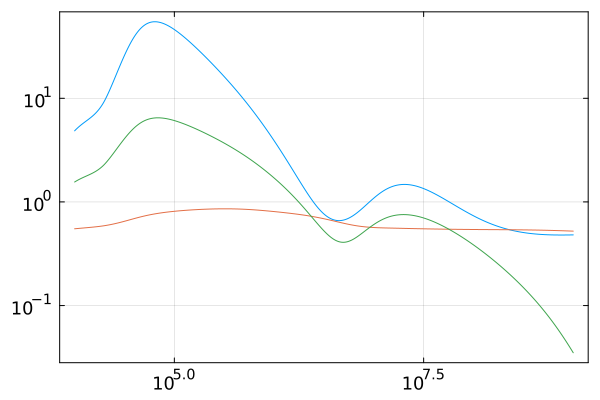

In [52]:
plot(kList, [g1g1bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)
plot!(kList, [g2g2bar(kList[i]) for i=1:length(kList)])
plot!(kList, [g1g2bar(kList[i]) for i=1:length(kList)])

In [129]:
@time begin
    f = open("data/hk.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hList = reduce(hcat,numarray);


    f = open("data/hkp.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hpList = reduce(hcat,numarray);
end;

 37.036516 seconds (1.43 M allocations: 3.627 GiB, 79.28% gc time, 1.65% compilation time)


In [130]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

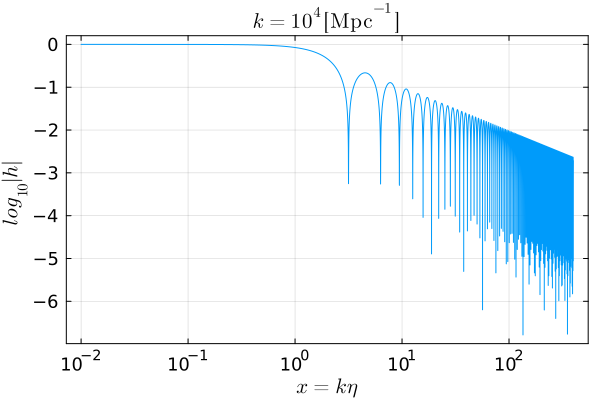

In [131]:
plot(xList, [log10(abs(hint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

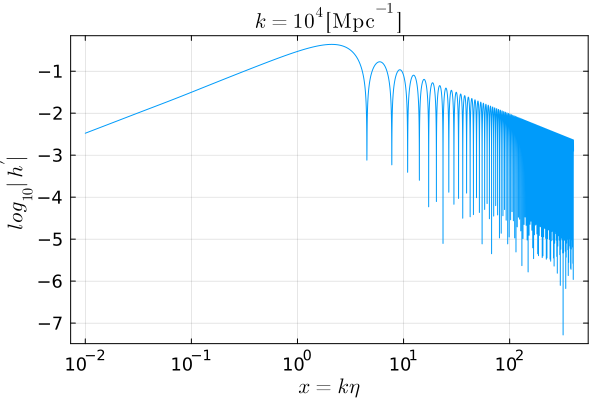

In [132]:
plot(xList, [log10(abs(hpint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [133]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [134]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

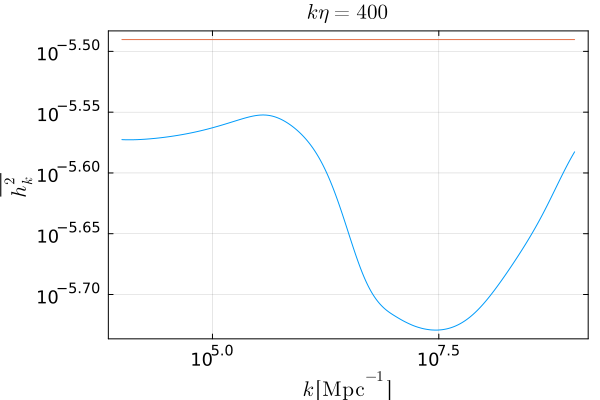

In [135]:
plot(kList, [h2bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, ylabel=L"\overline{h_k^2}", xlabel=L"k\,[\mathrm{Mpc}^{-1}]", title=L"k\eta=400")
plot!(kList, [h2barRD for i=1:length(kList)])

In [136]:
h2barRD/h2bar(1e5)

1.1818180737700592

In [137]:
g1g1List = [g1g1bar(kList[i]) for i=1:length(kList)];
g1g2List = [g1g2bar(kList[i]) for i=1:length(kList)];
g2g2List = [g2g2bar(kList[i]) for i=1:length(kList)];
coeffList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /24*(kList[i]/calHint(xf/kList[i]))^2 #*64/81/aint(xf/kList[i])^2 
    for i=1:length(kList)];
OlinList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /12*(kList[i]/calHint(xf/kList[i]))^2 * h2bar(kList[i]) for i=1:length(kList)];

In [138]:
open("data/noep/g1g2coeff.dat","w") do out
    Base.print_array(out, hcat(log10.(kList[:]),g1g1List[:],g1g2List[:],g2g2List[:],coeffList[:],OlinList[:]))
end

## load

In [4]:
@time begin
    f = open("data/noep/g1.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1List = reduce(hcat,numarray);


    f = open("data/noep/g1p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1pList = reduce(hcat,numarray);


    f = open("data/noep/g2.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2List = reduce(hcat,numarray);


    f = open("data/noep/g2p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2pList = reduce(hcat,numarray);
end;

 16.351832 seconds (3.18 M allocations: 7.270 GiB, 7.03% gc time, 1.20% compilation time)


In [5]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [6]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

g1CSI = CubicSplineInterpolation((lnkspan, xspan), g1List);
function g1int(k,x) 
    if x < xi
        return g1RD(x)
    else
        return g1CSI(log10(k),x)
    end
end;

g1pCSI = CubicSplineInterpolation((lnkspan, xspan), g1pList);
function g1pint(k,x) 
    if x < xi
        return g1pRD(x)
    else
        return g1pCSI(log10(k),x)
    end
end;

g2CSI = CubicSplineInterpolation((lnkspan, xspan), g2List);
function g2int(k,x) 
    if x < xi
        return g2RD(x)
    else
        return g2CSI(log10(k),x)
    end
end;

g2pCSI = CubicSplineInterpolation((lnkspan, xspan), g2pList);
function g2pint(k,x) 
    if x < xi
        return g2pRD(x)
    else
        return g2pCSI(log10(k),x)
    end
end;

In [7]:
xplotList = [10^lnx for lnx=-5:0.01:2];

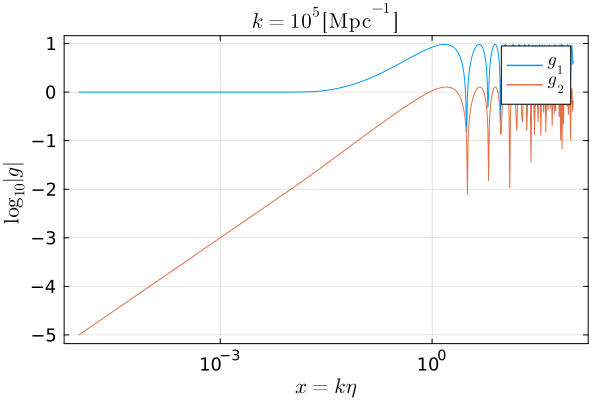

In [8]:
plot(xplotList, [log10(abs(g1int(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xplotList, [log10(abs(g2int(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, label=L"$g_2$")

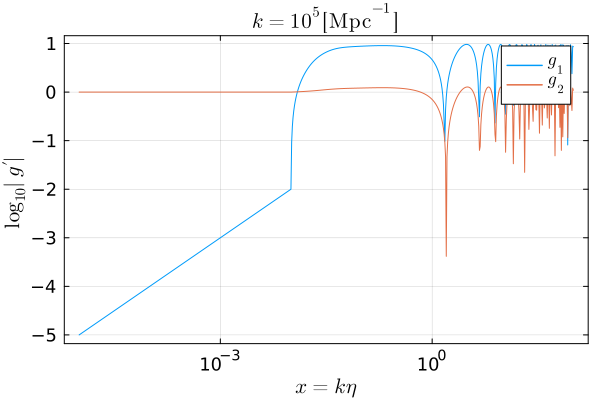

In [9]:
plot(xplotList, [log10(abs(g1pint(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xplotList, [log10(abs(g2pint(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, label=L"$g_2$")

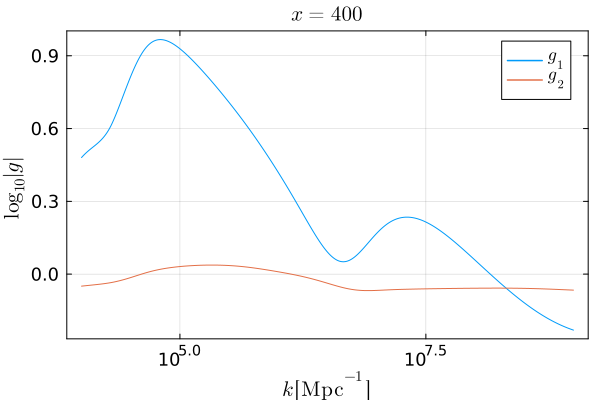

In [10]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

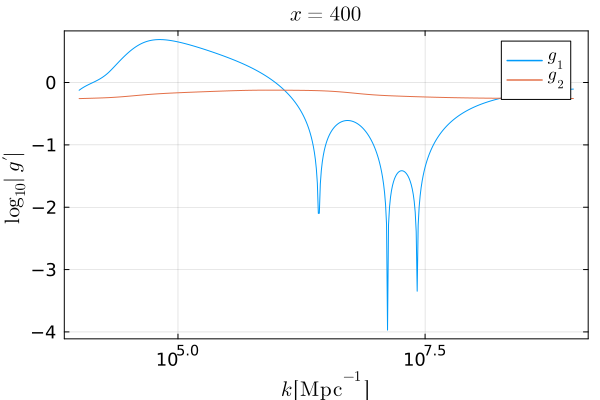

In [11]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

In [12]:
f = open("data/noep/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [13]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

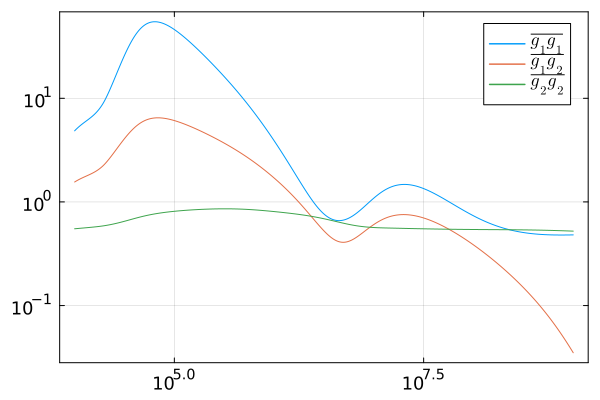

In [14]:
plot(kList, [g1g1int(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, legend=true, label=L"\overline{g_1g_1}")
plot!(kList, [g1g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_1g_2}")
plot!(kList, [g2g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_2g_2}")

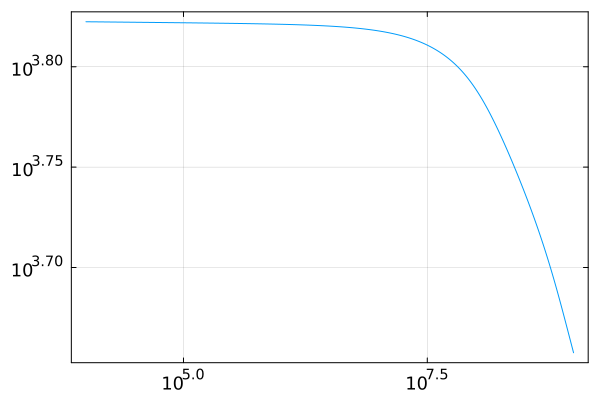

In [15]:
plot(kList, [coeffint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

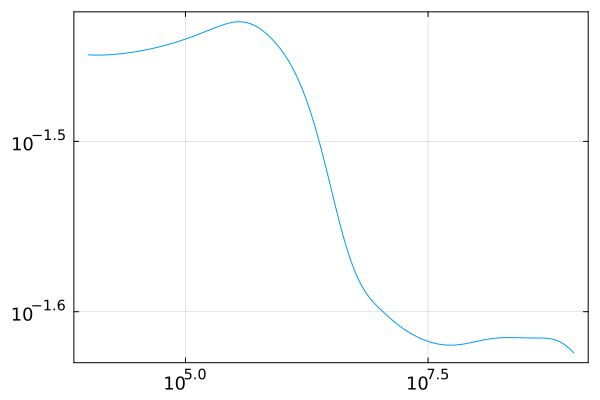

In [16]:
plot(kList, [Olinint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

In [17]:
kIR = 1e6;

g1int(kIR,kIR/5e8)^2*g2g2int(kIR) - 2*g1int(kIR,kIR/5e8)*g2int(kIR,kIR/5e8)*g1g2int(kIR) + g2int(kIR,kIR/5e8)^2*g1g1int(kIR)

0.8003775695511454

# Kernel

## monochromatic

In [4]:
f = open("data/noep/bg.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnetaList = [numarray[i][1] for i=1:length(numarray)];
anormList = [numarray[i][2] for i=1:length(numarray)];
calHList = [numarray[i][3] for i=1:length(numarray)];
EoSwList = [numarray[i][4] for i=1:length(numarray)];
cs2List = [numarray[i][5] for i=1:length(numarray)];
grhoList = [numarray[i][6] for i=1:length(numarray)];
gsList = [numarray[i][7] for i=1:length(numarray)];

In [5]:
lnetaspan = range(lnetaList[1], lnetaList[length(lnetaList)], length=length(lnetaList))
etai = 10^lnetaList[1];
etaf = 10^lnetaList[length(lnetaList)];

aCSI = CubicSplineInterpolation(lnetaspan, anormList);
aint(eta) = aCSI(log10(eta));

calHCSI = CubicSplineInterpolation(lnetaspan, calHList);
function calHint(eta) 
    if eta < etai
        return 1/eta
    else
        return calHCSI(log10(eta))
    end
end;

EoSwCSI = CubicSplineInterpolation(lnetaspan, EoSwList);
function EoSwint(eta) 
    if eta < etai
        return 1/3
    else
        return EoSwCSI(log10(eta))
    end
end;

cs2CSI = CubicSplineInterpolation(lnetaspan, cs2List);
function cs2int(eta) 
    if eta < etai
        return 1/3
    else
        return cs2CSI(log10(eta))
    end
end;

grhoCSI = CubicSplineInterpolation(lnetaspan, grhoList);
grhoint(eta) = grhoCSI(log10(eta));

gsCSI = CubicSplineInterpolation(lnetaspan, gsList);
gsint(eta) = gsCSI(log10(eta));

In [6]:
@time begin
    f = open("data/noep/Phi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PhiList = reduce(hcat,numarray);

    f = open("data/noep/Pi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PiList = reduce(hcat,numarray);
end;

  8.270290 seconds (1.46 M allocations: 3.629 GiB, 4.69% gc time, 0.95% compilation time)


In [7]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = 3*(9*x*cos(x/sqrt(3)) + sqrt(3)*(x^2-9)*sin(x/sqrt(3)))/x^4;
PhiRDf(x,Phif,Pif) = ((9*Phif*xf + 3*Pif*xf*(-x + xf) + Phif*x*(-9 + xf^2))*cos((x - xf)/sqrt(3)) 
    + sqrt(3)*(Pif*xf*(3 + x*xf) + Phif*(9 + 3*x*xf - xf^2))*sin((x - xf)/sqrt(3))) / x^3;
PhipRDf(x,Phif,Pif) = (3*(Pif*xf*(9*x - 9*xf + x^2*xf) 
        + 3*Phif*(-9*xf + x^2*xf - x*(-9 + xf^2)))*cos((x - xf)/sqrt(3)) 
    - sqrt(3)*(3*Pif*xf*(9 - x^2 + 3*x*xf) 
        + Phif*(27*x*xf - 9*(-9 + xf^2) + x^2*(-9 + xf^2)))*sin((x - xf)/sqrt(3))) / 3/x^4;

In [8]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

PhiCSI = CubicSplineInterpolation((lnkspan, xspan), PhiList);
function Phiint(k,x)
    if x < xi
        return PhiRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf)) 
    else
        return PhiCSI(log10(k),x)
    end;
end;

PiCSI = CubicSplineInterpolation((lnkspan, xspan), PiList);
function Piint(k,x) 
    if x < xi
        return PhipRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else
        return PiCSI(log10(k),x)
    end
end;

In [9]:
@time begin
    f = open("data/noep/g1.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1List = reduce(hcat,numarray);


    f = open("data/noep/g1p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g1pList = reduce(hcat,numarray);


    f = open("data/noep/g2.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2List = reduce(hcat,numarray);


    f = open("data/noep/g2p.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    g2pList = reduce(hcat,numarray);
end;

 18.487512 seconds (2.86 M allocations: 7.248 GiB, 19.09% gc time, 0.69% compilation time)


In [10]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [11]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

g1CSI = CubicSplineInterpolation((lnkspan, xspan), g1List);
function g1int(k,x) 
    if x < xi
        return g1RD(x)
    else
        return g1CSI(log10(k),x)
    end
end;

g1pCSI = CubicSplineInterpolation((lnkspan, xspan), g1pList);
function g1pint(k,x) 
    if x < xi
        return g1pRD(x)
    else
        return g1pCSI(log10(k),x)
    end
end;

g2CSI = CubicSplineInterpolation((lnkspan, xspan), g2List);
function g2int(k,x) 
    if x < xi
        return g2RD(x)
    else
        return g2CSI(log10(k),x)
    end
end;

g2pCSI = CubicSplineInterpolation((lnkspan, xspan), g2pList);
function g2pint(k,x) 
    if x < xi
        return g2pRD(x)
    else
        return g2pCSI(log10(k),x)
    end
end;

In [12]:
f = open("data/noep/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [13]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [14]:
function I1(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g1int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1i = k/k1*xi
        x2i = k/k2*xi
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,min(xi,x1i,x2i),min(xf,x1f,x2f))[1]
    end
end;

function I2(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g2int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1i = k/k1*xi
        x2i = k/k2*xi
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,min(xi,x1i,x2i),min(xf,x1f,x2f))[1]
    end
end;

In [18]:
kmin = 1e4;
kmax = 1e9;

ks = 1e8;

function OGW(i)
    if kList[i] > 2*ks
        return 0
    else
        u = ks/kList[i]
        t = 2*u-1
        s = 0
        
        I1tmp = I1(kList[i],s,t)
        I2tmp = I2(kList[i],s,t)

        I2bartmp = I1tmp^2 * g2g2int(kList[i]) - 2*I1tmp*I2tmp*g1g2int(kList[i]) + I2tmp^2 * g1g1int(kList[i])

        return 4*coeffint(kList[i]) * ((4*u^2-1)/4/u)^2 * I2bartmp
    end
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [19]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    if k > 2*k
        return 0
    else
        u = ks/k
        t = 2*u-1
        s = 0

        return 4*coeffint(k) * ((4*u^2-1)/4/u)^2 * I2RD(s,t)
    end
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [20]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = [i for i=1:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

  1.355358 seconds (23.40 M allocations: 522.234 MiB, 4.06% gc time, 805.62% compilation time)


In [21]:
iRDList = [i for i=1:391];
kRDList = [kList[iRDList[i]] for i=1:length(iRDList)];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iRDList);

  0.054283 seconds (136.52 k allocations: 8.164 MiB, 624.92% compilation time)


In [23]:
function OGWRDanal(kt)
    if kt > 2
        return 0
    else
        OGWRDanal = (4+(3*kt^2-2)*log(abs(1-4/3/kt^2)))^2
        if 3*kt < 2*sqrt(3)
            OGWRDanal += π^2*(3*kt^2-2)^2
        end
        
        OGWRDanal *= 3/64*((4-kt^2)/4)^2*kt^2*(3*kt^2-2)^2
        
        return OGWRDanal
    end
end;

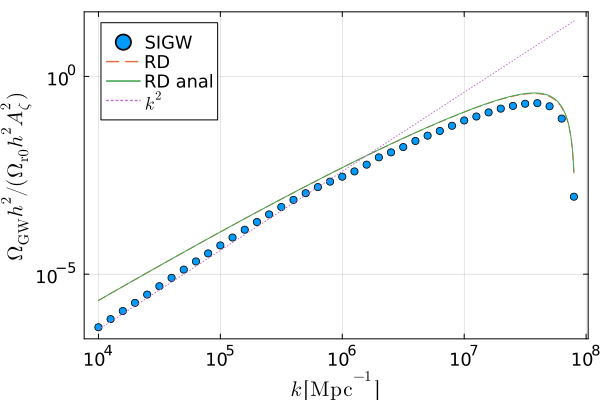

In [24]:
plot(kGWList#*MpcinvinHz/2/π*1e9
    , OGWdata, xlabel=#L"$f\,[\mathrm{nHz}]$"
    L"k\,[\mathrm{Mpc}^{-1}]", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, 
    legend=:topleft, label="SIGW", 
    xscale=:log10, yscale=:log10)
plot!(kRDList#*MpcinvinHz/2/π*1e9, #[18*Olinint(kRDList[i]) for i=1:length(kRDList)]
    , OGWRDdata, linestyle=:dash, label=#"linear"
"RD")
plot!(kRDList, [OGWRDanal(kRDList[i]/ks) for i=1:length(kRDList)], label="RD anal")
plot!(kGWList, [10^1.6*(kGWList[i]/ks)^2 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^2$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

In [81]:
savefig("OGW_1e8_delta.pdf")

"/Users/yuichirotada/Documents/Univ/SIGW_QCD/math/OGW_1e8_delta.pdf"

# xiGW = 1e-7

In [4]:
f = open("data/bg.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnetaList = [numarray[i][1] for i=1:length(numarray)];
anormList = [numarray[i][2] for i=1:length(numarray)];
calHList = [numarray[i][3] for i=1:length(numarray)];
EoSwList = [numarray[i][4] for i=1:length(numarray)];
cs2List = [numarray[i][5] for i=1:length(numarray)];
grhoList = [numarray[i][6] for i=1:length(numarray)];
gsList = [numarray[i][7] for i=1:length(numarray)];

In [5]:
lnetaspan = range(lnetaList[1], lnetaList[length(lnetaList)], length=length(lnetaList))
etai = 10^lnetaList[1];
etaf = 10^lnetaList[length(lnetaList)];

aCSI = CubicSplineInterpolation(lnetaspan, anormList);
aint(eta) = aCSI(log10(eta));

calHCSI = CubicSplineInterpolation(lnetaspan, calHList);
function calHint(eta) 
    if eta < etai
        return 1/eta
    else
        return calHCSI(log10(eta))
    end
end;

EoSwCSI = CubicSplineInterpolation(lnetaspan, EoSwList);
function EoSwint(eta) 
    if eta < etai
        return 1/3
    else
        return EoSwCSI(log10(eta))
    end
end;

cs2CSI = CubicSplineInterpolation(lnetaspan, cs2List);
function cs2int(eta) 
    if eta < etai
        return 1/3
    else
        return cs2CSI(log10(eta))
    end
end;

grhoCSI = CubicSplineInterpolation(lnetaspan, grhoList);
grhoint(eta) = grhoCSI(log10(eta));

gsCSI = CubicSplineInterpolation(lnetaspan, gsList);
gsint(eta) = gsCSI(log10(eta));

In [6]:
k = 1e5;

xiGW = 1e-7;
xf = 400;
xList = [10^lnx for lnx=log10(xiGW):0.01:log10(xf)];

In [7]:
function gkEoM(du,u,p,x) # u[1] = g, u[2] = dgdx, p[1] = k
    du[1] = u[2]
    du[2] = - (1 - (1-3*EoSwint(x/p[1]))/2*calHint(x/p[1])^2/p[1]^2)*u[1]
end;

xspan = (xiGW, xf);

function gk1e5(ui)
    p = [1e5]
    tensorprob = ODEProblem(gkEoM,ui,xspan,p)
    tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
    gsol(x) = tensorsol(x)[1]
    gpsol(x) = tensorsol(x)[2]
    return [gsol,gpsol]
end;

In [8]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [9]:
ui1 = [g1RD(xiGW),g1pRD(xiGW)];
ui2 = [g2RD(xiGW),g2pRD(xiGW)];

@time g11e5, g1p1e5 = gk1e5(ui1);
@time g21e5, g2p1e5 = gk1e5(ui2);

  0.520432 seconds (2.92 M allocations: 122.782 MiB, 4.88% gc time, 88.77% compilation time)
  0.051280 seconds (1.24 M allocations: 25.911 MiB, 18.06% gc time)


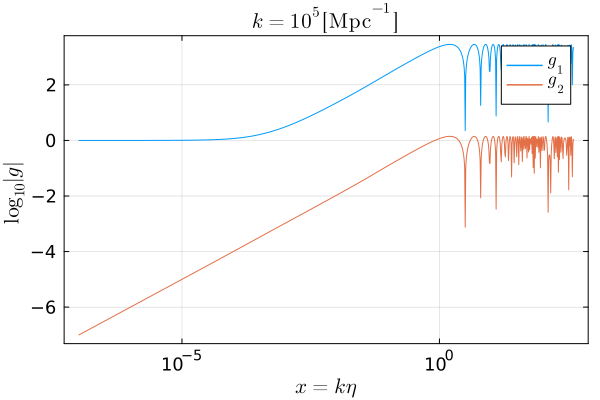

In [10]:
plot(xList, [log10(abs(g11e5(xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g21e5(xList[i]))) for i=1:length(xList)], label=L"$g_2$")

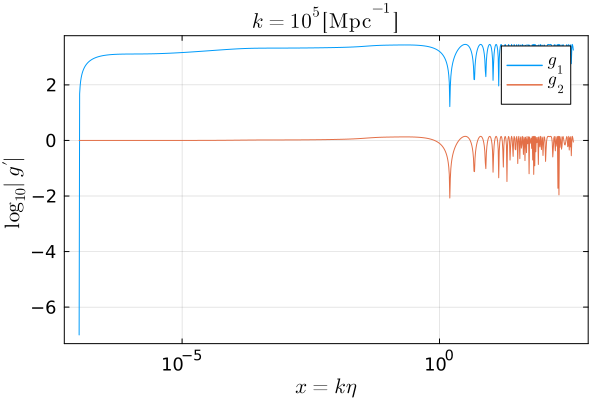

In [11]:
plot(xList, [log10(abs(g1p1e5(xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g2p1e5(xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

In [12]:
dx = 2*2*π;

function g1g1bar1e5()
    f(x) = g11e5(x)*g11e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g2g2bar1e5()
    f(x) = g21e5(x)*g21e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g1g2bar1e5()
    f(x) = g11e5(x)*g21e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [13]:
@time begin
    f = open("data/Phi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PhiList = reduce(hcat,numarray);

    f = open("data/Pi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PiList = reduce(hcat,numarray);
end;

  8.358915 seconds (1.46 M allocations: 3.629 GiB, 5.78% gc time, 0.96% compilation time)


In [14]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = 3*(9*x*cos(x/sqrt(3)) + sqrt(3)*(x^2-9)*sin(x/sqrt(3)))/x^4;
PhiRDf(x,Phif,Pif) = ((9*Phif*xf + 3*Pif*xf*(-x + xf) + Phif*x*(-9 + xf^2))*cos((x - xf)/sqrt(3)) 
    + sqrt(3)*(Pif*xf*(3 + x*xf) + Phif*(9 + 3*x*xf - xf^2))*sin((x - xf)/sqrt(3))) / x^3;
PhipRDf(x,Phif,Pif) = (3*(Pif*xf*(9*x - 9*xf + x^2*xf) 
        + 3*Phif*(-9*xf + x^2*xf - x*(-9 + xf^2)))*cos((x - xf)/sqrt(3)) 
    - sqrt(3)*(3*Pif*xf*(9 - x^2 + 3*x*xf) 
        + Phif*(27*x*xf - 9*(-9 + xf^2) + x^2*(-9 + xf^2)))*sin((x - xf)/sqrt(3))) / 3/x^4;

In [15]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

PhiCSI = CubicSplineInterpolation((lnkspan, xspan), PhiList);
function Phiint(k,x)
    if x < xi
        return PhiRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf)) 
    else
        return PhiCSI(log10(k),x)
    end;
end;

PiCSI = CubicSplineInterpolation((lnkspan, xspan), PiList);
function Piint(k,x) 
    if x < xi
        return PhipRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else
        return PiCSI(log10(k),x)
    end
end;

In [16]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [17]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [22]:
function I11e5(s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g11e5(x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,xiGW,min(xf,x1f,x2f))[1]
    end
end;

function I21e5(s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g21e5(x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,xiGW,min(xf,x1f,x2f))[1]
    end
end;

lntspan = -5.:0.01:5;
sspan = 0:0.01:1;
tList = [10^lnt for lnt=lntspan];
sList = [s for s=sspan];

function I11e5List()
    I1List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I1List[i,j] = I11e5(sList[i],tList[j])
        end
    end
    return I1List
end;

function I21e5List()
    I2List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2List[i,j] = I21e5(sList[i],tList[j])
        end
    end
    return I2List
end;

In [23]:
@time I11e5data = I11e5List();
@time I21e5data = I21e5List();

816.906808 seconds (134.49 G allocations: 2.064 TiB, 23.17% gc time, 0.32% compilation time)
927.238699 seconds (136.91 G allocations: 2.102 TiB, 21.52% gc time, 0.24% compilation time)


In [29]:
open(string("data/I1_1e5_xi=1e-7.dat"),"w") do out
    Base.print_array(out, I11e5data)
end

open(string("data/I2_1e5_xi=1e-7.dat"),"w") do out
    Base.print_array(out, I21e5data)
end

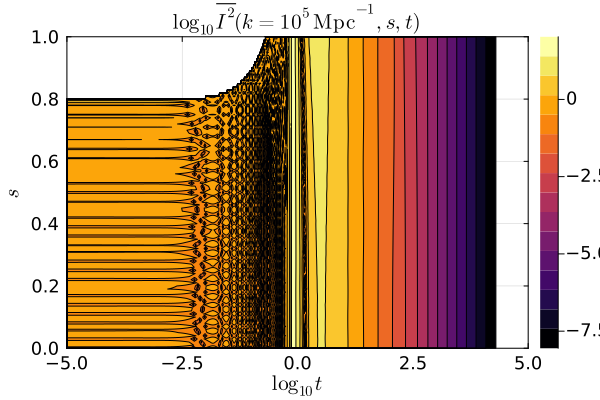

In [25]:
contourf(lntspan,sspan,log10.(abs.(I11e5data)), title=L"$\log_{10}\overline{I^2}(k=10^5\,\mathrm{Mpc}^{-1},s,t)$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true)

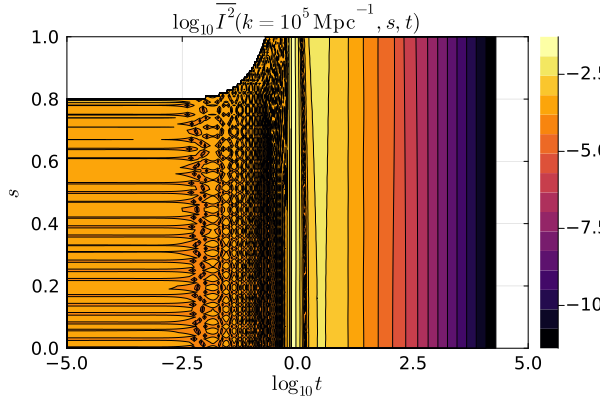

In [26]:
contourf(lntspan,sspan,log10.(abs.(I21e5data)), title=L"$\log_{10}\overline{I^2}(k=10^5\,\mathrm{Mpc}^{-1},s,t)$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true)

In [28]:
tmin = 1e-5;
tmax = 1e5;

σ2 = 0.25;
ks = 5e8;
ns = 3;
#calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);
function calPz(k)
    if k<ks
        return (k/ks)^(ns-1)
    else
        return 0
    end
end;

I11e5CSI = CubicSplineInterpolation((sspan, lntspan), I11e5data)
I11e5int(s,t) = I11e5CSI(s,log10(t))
    
I21e5CSI = CubicSplineInterpolation((sspan, lntspan), I21e5data)
I21e5int(s,t) = I21e5CSI(s,log10(t))
    
I2bar1e5int(s,t) = (I11e5int(s,t)^2 * g2g2bar1e5() - 2*I11e5int(s,t)*I21e5int(s,t)*g1g2bar1e5() 
    + I21e5int(s,t)^2 * g1g1bar1e5())
    
calPh1e5int(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2bar1e5int(s,t) * calPz((t+s+1)/2*1e5) 
    * calPz((t-s+1)/2*1e5));
    
4*coeffint(1e5) * dblquad(calPh1e5int,tmin,tmax,0,1;method=:divonne)[1]

4.325223108114423e-10